# Problem 1  (Moglen 2015)

A rectangular channel, 5 m wide, carries a flow of 20 m3/s. The slope of the channel S0 = 0.005 m/m, and Manning’s n is 0.030. The flow encounters a sluice gate open to 0.60 meters. The depths far upstream and downstream of the gate are equal to the normal depth, $y_0$.

 a. Calculate y0.
 
 b. Determine if the reach is mild, steep, or critical.
 
 c. Sketch all profiles both upstream and downstream of the obstructions.
 
 d. On your sketch, indicate the upstream and downstream depths of each profile you draw and provide supporting calculations.
 
 e. Sketch the cycle of points on the E-y diagram for each of the upstream and downstream depths identified in part (d) and label sections of the cycle that correspond to any surface water profiles, jumps, or in-stream obstructions

### 1a. Calculate y0.

In [153]:
import numpy as np
from scipy.optimize import fsolve

#======
# Given
#======
w = 5
Q = 20
S_o = 0.005
n = 0.03
k = 1
y_gate = 0.6

#=====
# Find
#=====

# y_o
def manning_equation(y, w, S_o, k, n):
    A = w * y
    P = w + 2 * y
    R = A / P
    return ((k / n) * A * R**(2/3) * np.sqrt(S_o) - Q)

yguess = 1.26

y_o = fsolve(manning_equation, yguess, args=(w, S_o, k, n))


#========
# Answers
#========

print("Normal Depth (m) =", np.round(y_o, 2))

Normal Depth (m) = [1.69]


### 1b. Determine if the reach is mild, steep, or critical.

In [154]:
import numpy as np
from scipy.optimize import fsolve

#======
# Given
#======
w = 5
Q = 20
S_o = 0.005
n = 0.03
k = 1
y_gate = 0.6
g = 9.81

#=======
# Found
#=======
# y_o
def manning_equation(y, w, S_o, k, n):
    A = w * y
    P = w + 2 * y
    R = A / P
    return ((k / n) * A * R**(2/3) * np.sqrt(S_o) - Q)

yguess = 1.26

y_o = fsolve(manning_equation, yguess, args=(w, S_o, k, n))

#=====
# Find
#=====
q = Q / w
y_c = (q**2 / g)**(1/3)

#========
# Answers
#========
if y_c == y_o: 
    print("Critical Slope")
elif y_c > y_o:
    print("Steep Slope")
elif y_c < y_o:
    print("Mild Slope")

#print("Normal Depth (m) =", np.round(y_o, 2))
print("Critical Depth (m) =", np.round(y_c, 2))

Mild Slope
Critical Depth (m) = 1.18


### 1c. Sketch all profiles both upstream and downstream of the obstructions.

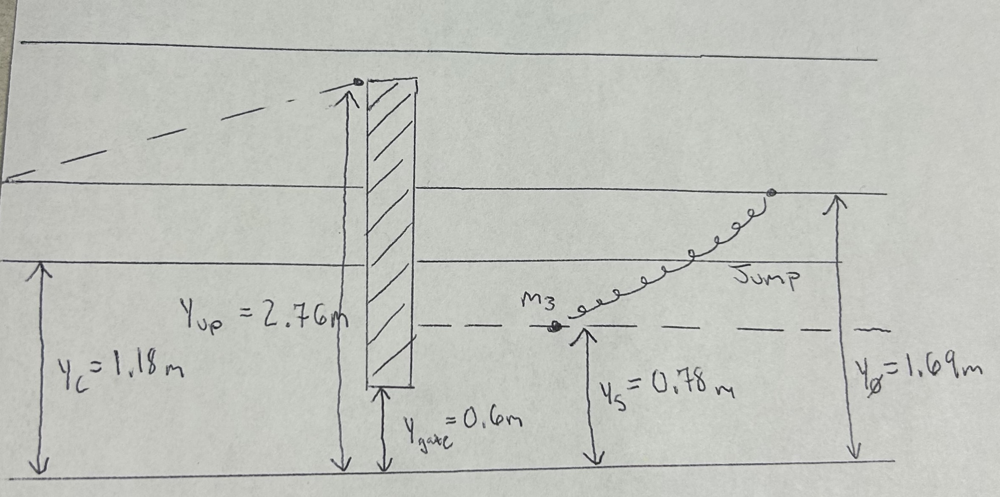

### 1d. On your sketch, indicate the upstream and downstream depths of each profile you draw and provide supporting calculations.

In [155]:
import numpy as np
from scipy.optimize import fsolve

#======
# Given
#======
w = 5
Q = 20
S_o = 0.005
n = 0.03
k = 1
y_gate = 0.6
g = 9.81

#=======
# Found
#=======

def manning_equation(y, w, S_o, k, n):
    A = w * y
    P = w + 2 * y
    R = A / P
    return ((k / n) * A * R**(2/3) * np.sqrt(S_o) - Q)
yguess = 1.26
y_o = fsolve(manning_equation, yguess, args=(w, S_o, k, n))

q = Q / w
y_c = (q**2 / g)**(1/3)

#=====
# Find
#=====

E_o = y_o + (q**2 / (2 * g * y_o**2))
E_gate = y_gate + (q**2 / (2 * g * y_gate**2))

y_up = (2 * y_gate) / (-1 + (1 + 8 * g * y_gate**3 / q**2)**0.5)

Fr_o = (Q / (w * y_o)) / (g * y_o)**0.5
y_s = y_o * 0.5 * (-1 + (1 + 8 * Fr_o**2)**0.5)

#========
# Answers
#========

print("Normal Depth (m) =", np.round(y_o, 2))
print("Critical Depth (m) =", np.round(y_c, 2))
print("Depth Directly Upstream of Gate (m)=", np.round(y_up, 2))
print("Depth at Gate (m) =", y_gate)
print("Sequent Depth Just Down Stream of Gate (m)=", np.round(y_s, 2))

Normal Depth (m) = [1.69]
Critical Depth (m) = 1.18
Depth Directly Upstream of Gate (m)= 2.76
Depth at Gate (m) = 0.6
Sequent Depth Just Down Stream of Gate (m)= [0.78]


### 1e. Sketch the cycle of points on the E-y diagram for each of the upstream and downstream depths identified in part (d) and label sections of the cycle that correspond to any surface water profiles, jumps, or in-stream obstructions

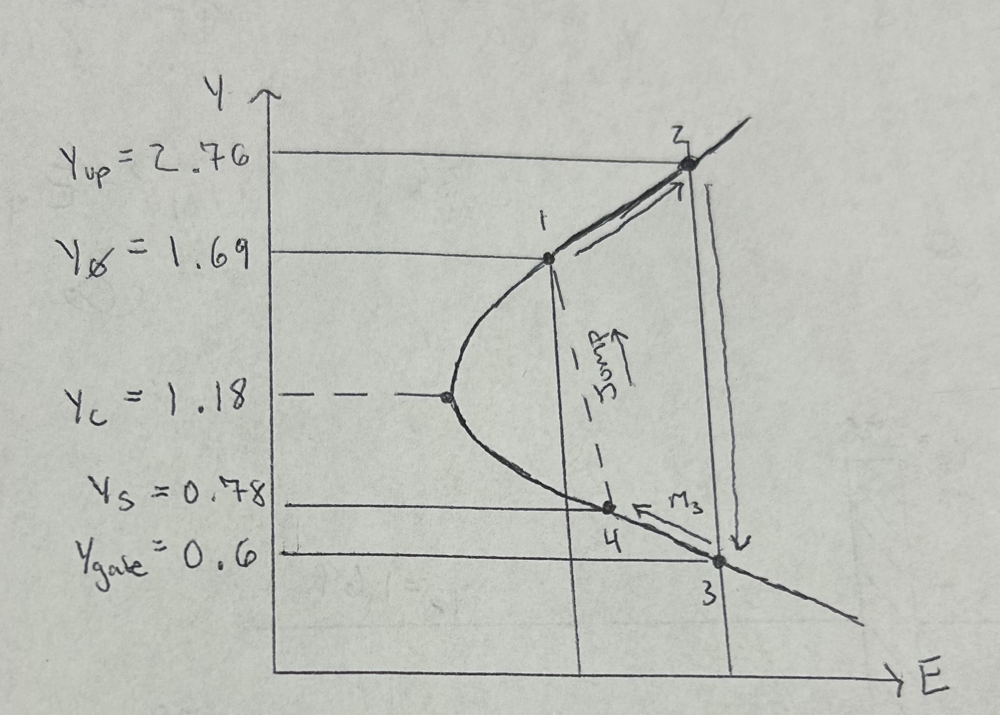

---

# Problem 2 (Moglen 5.3)

A rectangular channel, 5 m wide, carries a flow of 20 m3/s. The slope of the channel S0 = 0.02 m/m, and Manning’s n is 0.030. The flow enters a rectangular constriction to a width of 3 meters. The depths far upstream and downstream of the constriction are equal to the normal depth, y0. Sketch below is given in plan view. Assume no energy is lost in the contraction.

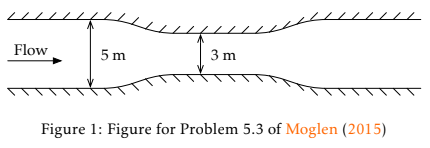

a. Calculate y0.

b. Determine if the reach is mild, steep, or critical.

c. Sketch all profiles both upstream and downstream of the obstructions.

d. On your sketch, indicate the upstream and downstream depths of each profile you draw and provide supporting calculations.

e. Sketch the cycle of points on the E-y diagram for each of the upstream and downstream depths identified in part (d) and label sections of the cycle that correspond to any surface water profiles, jumps, or in-stream obstructions

### 2a. Calculate y0.

In [156]:
from scipy.optimize import fsolve
import numpy as np

b_1 = 5
b_2 = 3
Q = 20
S_o = 0.02
n = 0.030
k = 1

def normal_depth (y, b_1, Q, S_o, n, k):
    A = b_1 * y
    P = b_1 + 2 * y
    R = A/P
    return (((k/n) * A * R**(2/3) * S_o**(1/2)) - Q)

yguess = 1

y_o1 = fsolve(normal_depth, yguess, args=(b_1, Q, S_o, n, k))
y_o2 = fsolve(normal_depth, yguess, args=(b_2, Q, S_o, n, k))

print("Normal Depth (m) Up/Down Stream =", np.round(y_o1, 2))
print("Normal Depth (m) Constriction =", np.round(y_o2, 2))

Normal Depth (m) Up/Down Stream = [1.04]
Normal Depth (m) Constriction = [1.66]


### 2b. Determine if the reach is mild, steep, or critical.

In [157]:
from scipy.optimize import fsolve
import numpy as np

b_1 = 5
b_2 = 3
Q = 20
S_o = 0.02
n = 0.030
k = 1
g = 9.81
def normal_depth (y, b_1, Q, S_o, n, k):
    A = b_1 * y
    P = b_1 + 2 * y
    R = A/P
    return (((k/n) * A * R**(2/3) * S_o**(1/2)) - Q)
yguess = 2
y_o1 = fsolve(normal_depth, yguess, args=(b_1, Q, S_o, n, k))
y_o2 = fsolve(normal_depth, yguess, args=(b_2, Q, S_o, n, k))

y_c1 = ((Q/b_1)**2 /g)**(1/3)
y_c2 = ((Q/b_2)**2 /g)**(1/3)

if y_o1 > y_c1:
    print("Mild Slope (Up/Down Stream),", "Normal Depth", np.round(y_o1, 2), "> Critical Depth", np.round(y_c1, 2))
elif y_o1 < y_c1:
    print("Steep Slope (Up/Down Stream),", "Normal Depth", np.round(y_o1, 2), "< Critical Depth", np.round(y_c1, 2))
elif y_o1 == y_c1:
    print("Critical Slope (Up/Down Stream),", "Normal Depth", np.round(y_o1, 2), "< Critical Depth", np.round(y_c1, 2))
    
if y_o2 > y_c2:
    print("Mild Slope (Contraction),", "Normal Depth", np.round(y_o2, 2), "> Critical Depth", np.round(y_c2, 2))
elif y_o2 < y_c2:
    print("Steep Slope (Contraction),", "Normal Depth", np.round(y_o2, 2), "< Critical Depth", np.round(y_c2, 2))
elif y_o2 == y_c2:
    print("Critical Slope (Contraction),", "Normal Depth", np.round(y_o2, 2), "< Critical Depth", np.round(y_c2, 2))

Steep Slope (Up/Down Stream), Normal Depth [1.04] < Critical Depth 1.18
Mild Slope (Contraction), Normal Depth [1.66] > Critical Depth 1.65


### 2c. Sketch all profiles both upstream and downstream of the obstructions.

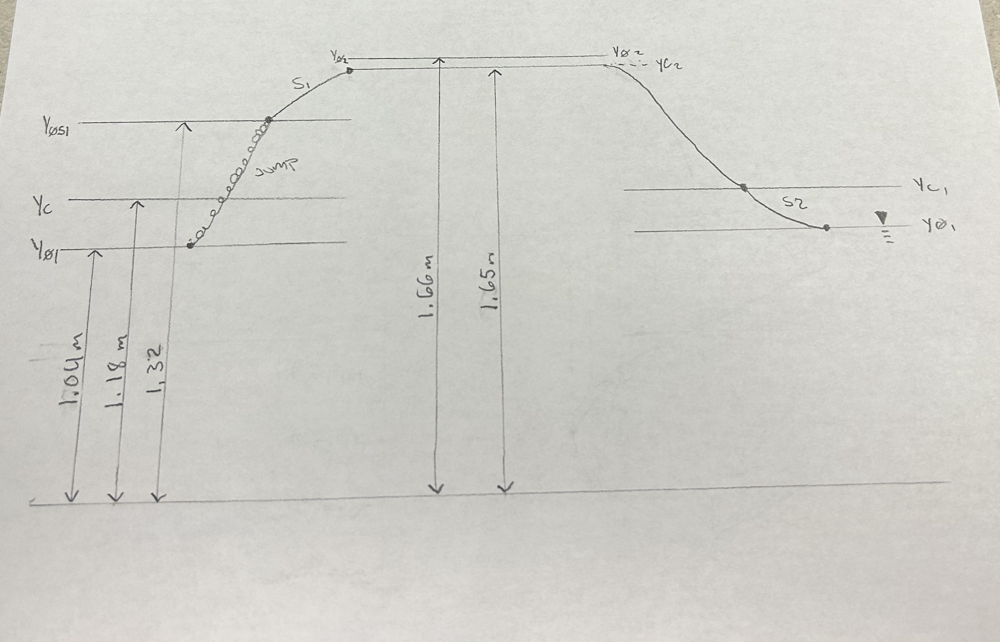

### 2d. On your sketch, indicate the upstream and downstream depths of each profile you draw and provide supporting calculations

Assuming:

length in contraction is not long enough to reach normal depth

Jump is happening before contraction since problem states no energy loss occurs within contraction

In [158]:
from scipy.optimize import fsolve
import numpy as np

b_1 = 5
b_2 = 3
Q = 20
S_o = 0.02
n = 0.030
k = 1
g = 9.81

q_1 = Q / b_1
q_2 = Q / b_2

# =============
# Normal Depths
# =============

def normal_depth (y, b_1, Q, S_o, n, k):
    A = b_1 * y
    P = b_1 + 2 * y
    R = A/P
    return (((k/n) * A * R**(2/3) * S_o**(1/2)) - Q)
yguess = 2
y_o1 = fsolve(normal_depth, yguess, args=(b_1, Q, S_o, n, k))
y_o2 =fsolve(normal_depth, yguess, args=(b_2, Q, S_o, n, k))

E_o = y_o1 + q_1**2 / (2 * g * y_o1**2)
E_o2 = y_o2 + q_1**2 / (2 * g * y_o2**2)

# =============
# Critial Depths
# =============

y_c1 = (q_1**2 /g)**(1/3)
y_c2 = (q_2**2 / g)**(1/3)

E_1c = y_c1 + q_1**2 / (2 * g * y_c1**2)
E_2c = y_c2 + q_2**2 / (2 * g * y_c2**2)

# =============
# Conj. Depths
# =============

def conj_depth(f, b, y_oA, Q, g):
    A = b * y_oA
    Fr = (Q / A) / (g * y_oA) ** 0.5
    return (0.5 * ((1 + 8 * Fr ** 2) ** 0.5 - 1)) - (f / y_oA)
fguess = 1.1
y_s1 = fsolve(conj_depth, fguess, args=(b_1, y_o1, Q, g))
y_s2 = fsolve(conj_depth, fguess, args=(b_2, y_o2, Q, g))

E_1s = y_s1 + q_1**2 / (2 * g * y_s1**2)
E_2s = y_s2 + q_2**2 / (2 * g * y_s2**2)
# =============
# Answers
# =============

data = [
    ["Property", "Up/Down Stream", "Contraction"],
    ["Critical Depth (meters)", np.round(y_c1, 2), np.round(y_c2, 2)],
    ["Normal Depth (meters)", np.round(y_o1[0], 2), np.round(y_o2[0], 2)],
    ["Reach Type", "Steep", "mild (almost critical)"],
    ["Conjugate Depth (meters)", np.round(y_s1[0], 2), np.round(y_s2[0], 2)],
    ["E_o (meters)", np.round(E_o[0], 2), np.round(E_o2[0], 2)],
    ["E_c (meters)", np.round(E_1c, 2), np.round(E_2c, 2)],
    ["E_s (meters)", np.round(E_1s[0], 2), np.round(E_2s[0], 2)],
]

column_widths = [max(len(str(item)) for item in column) for column in zip(*data)]

for row in data:
    formatted_row = [f"{item:{width}}" for item, width in zip(row, column_widths)]
    print(" | ".join(formatted_row))


Property                 | Up/Down Stream | Contraction           
Critical Depth (meters)  |           1.18 |                   1.65
Normal Depth (meters)    |           1.04 |                   1.66
Reach Type               | Steep          | mild (almost critical)
Conjugate Depth (meters) |           1.32 |                   1.65
E_o (meters)             |           1.79 |                   1.95
E_c (meters)             |           1.77 |                   2.48
E_s (meters)             |           1.79 |                   2.48


### 2e. Sketch the cycle of points on the E-y diagram for each of the upstream and downstream depths identified in part (d) and label sections of the cycle that correspond to any surface water profiles, jumps, or in-stream obstructions

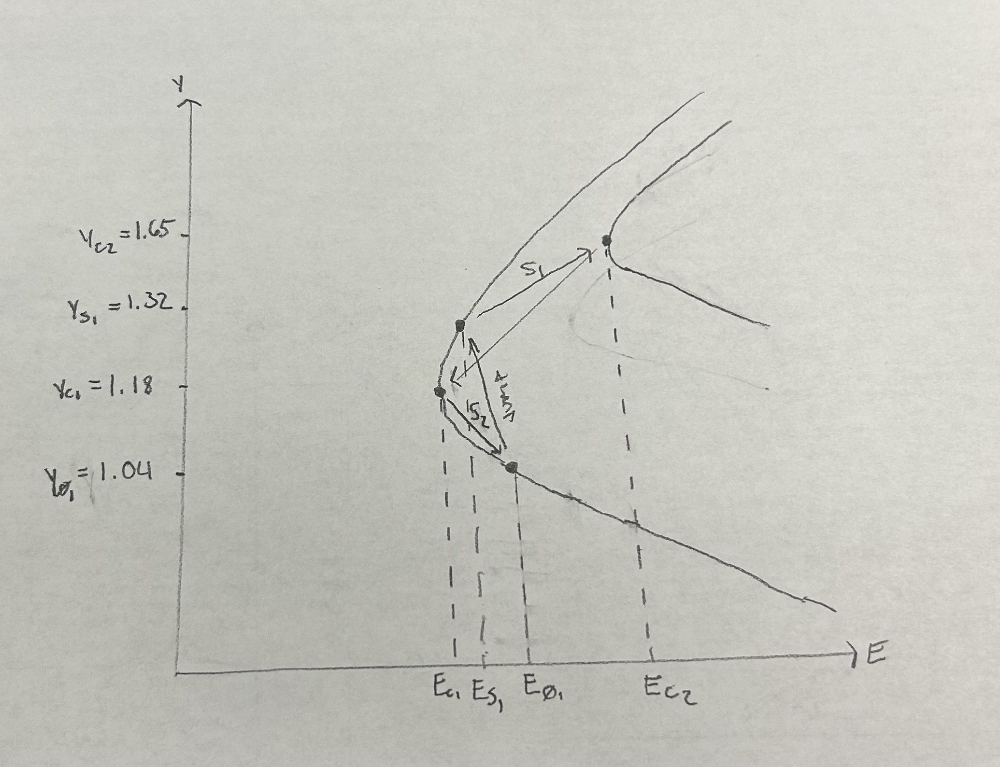

---

# Problem 3 (Moglen 5.8)

Given the junction of two rectangular reaches, A and B, carrying a discharge of 30m^3/s as in the following table:

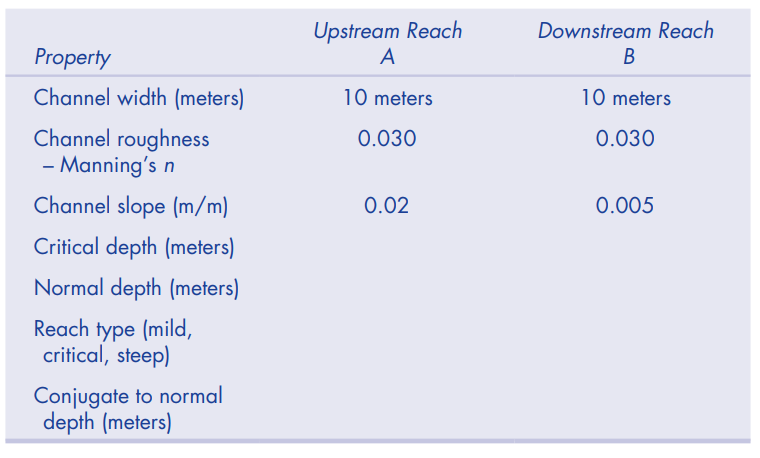

a. Fill in the missing entries in the last four rows of the above table.

b. Does the hydraulic jump appear on the upstream (A) or downstream (B) reach? Justify your answer.

c. Using normal depths as the upstream (entrance) and downstream (exit) conditions, sketch the flow profile through the two 
reaches. Label all profiles and indicate all key depths.

d. Answer the appropriate one of the two questions below:

    i. If your answer to Problem 5.8b placed the jump on Reach A, what is the least steep new slope for Reach A such that the jump moves downstream to Reach B?

    ii. If your answer to Problem 5.8b placed the jump on Reach B, what is the least steep new slope for Reach A such that the jump moves upstream to Reach A?

### 3a. Fill in the missing entries in the last four rows of the above table.

In [159]:
import numpy as np
from scipy.optimize import fsolve

Q = 30
b = 10
n = 0.030
S_oA = 0.02
S_oB = 0.005
g = 9.81
k = 1

# ==============
# Critical Depth
# ==============

y_c = ((Q / b)**2 / g) ** (1/3)

# ============
# Normal Depth
# ============

def normal_depth(y, b, Q, S_oA, n, k):
    A = b * y
    P = b + 2 * y
    R = A / P
    return (((k / n) * A * R **(2/3) * S_oA **(1/2)) - Q)

yguess = 1
y_oA = fsolve(normal_depth, yguess, args=(b, Q, S_oA, n, k))
y_oB = fsolve(normal_depth, yguess, args=(b, Q, S_oB, n, k))

# ===========
# Reach Class
# ===========

if y_oA > y_c:
    reach_A = "Mild"
elif y_oA < y_c:
    reach_A = "Steep"
else:
    reach_A = "Critical"

if y_oB > y_c:
    reach_B = "Mild"
elif y_oB < y_c:
    reach_B = "Steep"
else:
    reach_B = "Critical"

# ==========
# Conj Depth
# ==========

def conj_depth(f, b, y_oA, Q, g):
    A = b * y_oA
    Fr = (Q / A) / (g * y_oA) ** 0.5
    return (0.5 * ((1 + 8 * Fr ** 2) ** 0.5 - 1)) - (f / y_oA)

fguess = 1
y_sA = fsolve(conj_depth, fguess, args=(b, y_oA, Q, g))
y_sB = fsolve(conj_depth, fguess, args=(b, y_oB, Q, g))

# ============
# Output Table
# ============

data = [
    ["Property", "Upstream Reach A", "Downstream Reach B"],
    ["Channel Width (meters)", b, b],
    ["Channel Roughness (Manning's n)", n, n],
    ["Channel Slope (m/m)", S_oA, S_oB],
    ["Critical Depth (meters)", np.round(y_c, 2), np.round(y_c, 2)],
    ["Normal Depth (meters)", np.round(y_oA[0], 2), np.round(y_oB[0], 2)],
    ["Reach Type", reach_A, reach_B],
    ["Conjugate Depth (meters)", np.round(y_sA[0], 2), np.round(y_sB[0], 2)],
]

column_widths = [max(len(str(item)) for item in column) for column in zip(*data)]

for row in data:
    formatted_row = [f"{item:{width}}" for item, width in zip(row, column_widths)]
    print(" | ".join(formatted_row))
    

Property                        | Upstream Reach A | Downstream Reach B
Channel Width (meters)          |               10 |                 10
Channel Roughness (Manning's n) |             0.03 |               0.03
Channel Slope (m/m)             |             0.02 |              0.005
Critical Depth (meters)         |             0.97 |               0.97
Normal Depth (meters)           |             0.81 |               1.26
Reach Type                      | Steep            | Mild              
Conjugate Depth (meters)        |             1.15 |               0.73


### 3b. Does the hydraulic jump appear on the upstream (A) or downstream (B) reach? Justify your answer.

In [160]:
import numpy as np
from scipy.optimize import fsolve

Q = 30
b = 10
n = 0.030
S_oA = 0.02
S_oB = 0.005
g = 9.81
k = 1

def normal_depth(y, b, Q, S_oA, n, k):
    A = b * y
    P = b + 2 * y
    R = A / P
    return (((k / n) * A * R **(2/3) * S_oA **(1/2)) - Q)

yguess = 1
y_oA = fsolve(normal_depth, yguess, args=(b, Q, S_oA, n, k))
y_oB = fsolve(normal_depth, yguess, args=(b, Q, S_oB, n, k))

def conj_depth(f, b, y_oA, Q, g):
    A = b * y_oA
    Fr = (Q / A) / (g * y_oA) ** 0.5
    return (0.5 * ((1 + 8 * Fr ** 2) ** 0.5 - 1)) - (f / y_oA)

fguess = 1
y_sA = fsolve(conj_depth, fguess, args=(b, y_oA, Q, g))
y_sB = fsolve(conj_depth, fguess, args=(b, y_oB, Q, g))

if y_oA < y_sB:
    print("Hydraulic Jump is Downstream:", "Normal Depth Upstream", np.round(y_oA, 2), 
          "< Conjugate Depth Downstream", np.round(y_sB, 2))
elif y_oA > y_sB:
    print("Hydraulic Jump is Upstream:", "Normal Depth Upstream", np.round(y_oA, 2), 
          "> Conjugate Depth Downstream", np.round(y_sB, 2))

Hydraulic Jump is Upstream: Normal Depth Upstream [0.81] > Conjugate Depth Downstream [0.73]


### 3c. Using normal depths as the upstream (entrance) and downstream (exit) conditions, sketch the flow profile through the two reaches. Label all profiles and indicate all key depths.

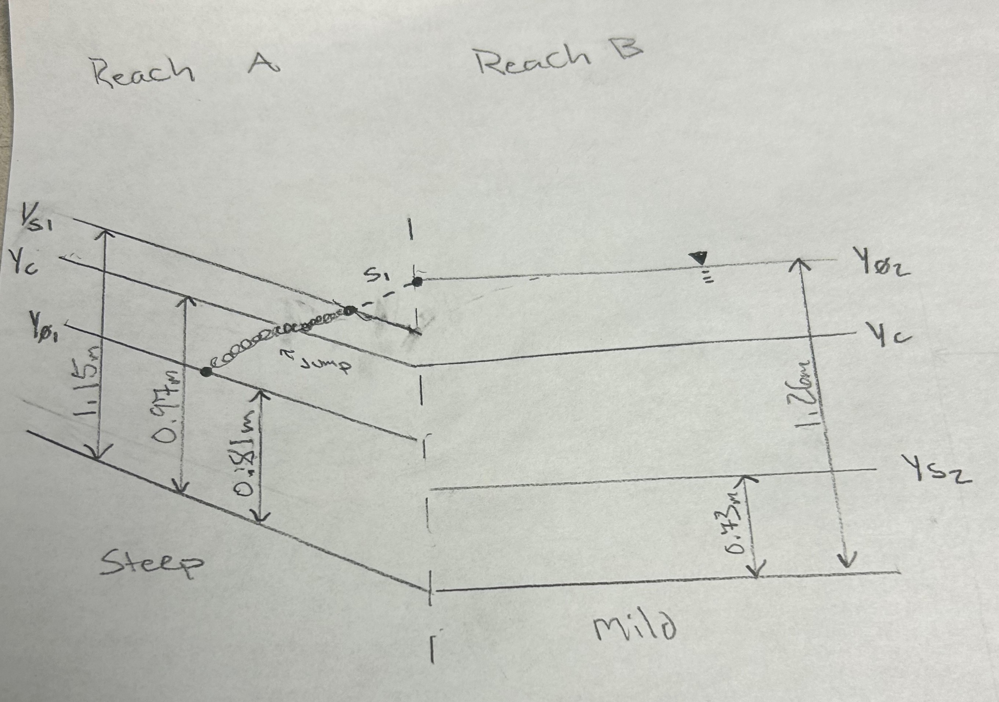

### 3d. If your answer to Problem 5.8b placed the jump on Reach A (upstream), what is the least steep new slope for Reach A such that the jump moves downstream to Reach B?

In [161]:
import numpy as np
from scipy.optimize import fsolve

Q = 30
b = 10
n = 0.030
S_oA = 0.02
S_oB = 0.005
g = 9.81
k = 1

def normal_depth(y, b, Q, S_oA, n, k):
    A = b * y
    P = b + 2 * y
    R = A / P
    return (((k / n) * A * R **(2/3) * S_oA **(1/2)) - Q)

yguess = 1
y_oA = fsolve(normal_depth, yguess, args=(b, Q, S_oA, n, k))
y_oB = fsolve(normal_depth, yguess, args=(b, Q, S_oB, n, k))

def conj_depth(f, b, y_oA, Q, g):
    A = b * y_oA
    Fr = (Q / A) / (g * y_oA) ** 0.5
    return (0.5 * ((1 + 8 * Fr ** 2) ** 0.5 - 1)) - (f/ y_oA)

fguess = 0.5
y_sA = fsolve(conj_depth, fguess, args=(b, y_oA, Q, g))
y_sB = fsolve(conj_depth, fguess, args=(b, y_oB, Q, g))

def new_slope(S, b, y_sB, k, n, Q):
    A = b * y_sB
    P = b + 2 * y_sB
    R = A / P
    return (((k/n) * A * R**(2/3) * S**0.5) - Q)

sguess = 0.0
#print(y_sB)
min_slope = fsolve(new_slope, sguess, args=(b, y_sB, k, n, Q))

print("Minimum Slope for HJ to Move into Reach B is less than", np.round(min_slope, 4))
    

Minimum Slope for HJ to Move into Reach B is less than [0.028]


---

# Problem 4 (Moglen 5.10)

For each of the reach transitions shown below, sketch the water surface profile and label all curves (e.g., M1, S3, etc.), jumps, and regions of normal flow as illustrated. Note that there are two steep to mild transitions. One possibility is shown as an example. You must sketch the other possibility. Assume all upstream and downstream boundary conditions are normal depth

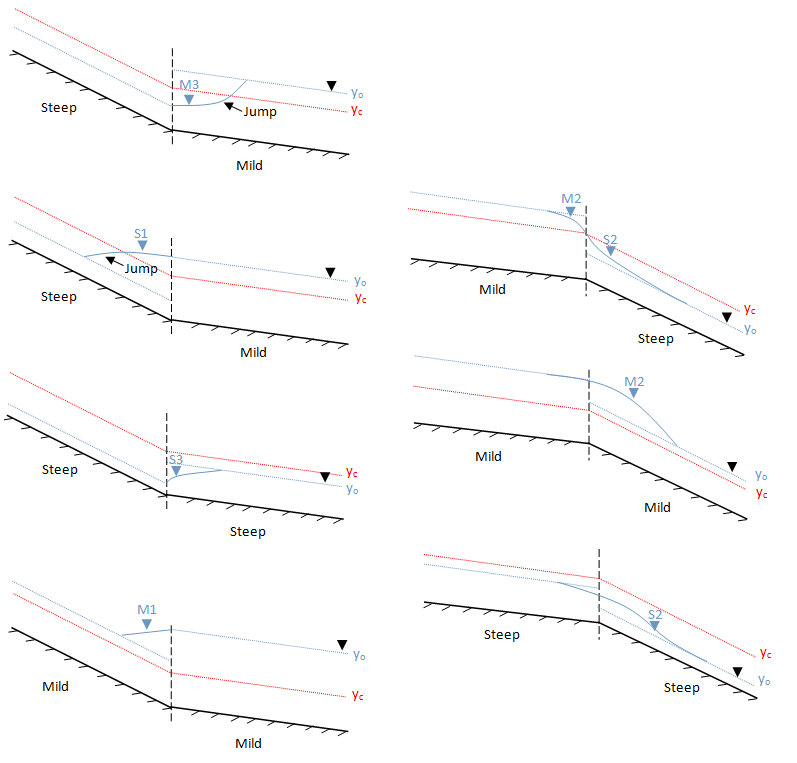


---

# Problem 5 (Moglen 5.13)

A channel carries a discharge of 10 m3/s in a 5 m wide rectangular cross-section. Downstream of the gate, the normal depth is 1.7 m. The flow encounters a sluice gate with an upstream depth as specified below. The sluice gate is set to an opening of 0.30 m. 

$\textit{Note:}$ The "upstream depths" in parts (a)-(c) should be thought of as "far upstream depths". For part (d) assume that you can adjust the gate to any opening you like.

a. If the upstream depth is 1.9 m, show that the jump is a drowned jump and determine the energy dissipated in the drowned jump.

b. Repeat from (a) with upstream depth 2.1 m.

c. Repeat from (a) with upstream depth 2.4 m.

d. Determine the minimum depth upstream of the sluice gate so that the jump is not drowned. How much energy is dissipated in 
this jump?

### 5a. If the upstream depth is 1.9 m, show that the jump is a drowned jump and determine the energy dissipated in the drowned jump.

In [162]:
from scipy.optimize import fsolve
import numpy as np

Q = 10
b = 5
y_o2 = 1.7
y_gate = 0.3
g = 9.81
y_o1 = 1.9
E_o2 = y_o2 + (Q/b)**2 / (2 * g * y_o2**2)
E_o1 = y_o1 + (Q/b)**2 / (2 * g * y_o1**2)
E_gate = y_gate + (Q/b)**2 / (2 * g * y_gate**2)

def alt_depth(y, Q, b, g):
    q = Q / b
    return (y**3 - E_gate * y**2 + q**2 / (2 * g))
yguess = y_o1
y_a1 = fsolve(alt_depth, yguess, args=(Q, b, g))


def sequent_depth(f, b, y_o2, g):
    A = b * y_o2
    Fr = (Q / A) / (g * y_o2)**0.5
    return (0.5 * (-1 + (1 + 8 * Fr**2)**0.5) - (f / y_o2))
fguess = 1

y_s2 = fsolve(sequent_depth, fguess, args=(b, y_o2, g))
y_s1 = fsolve(sequent_depth, fguess, args=(b, y_o1, g))

if y_s1 > y_gate:
    print("Jump is NOT Drowned, Sequent Depth", np.round(y_s1, 2), "> Gate Openening", y_gate)
elif y_s1 < y_gate:
    print("Jump is Drowned, Sequent Depth", np.round(y_s1, 2), "< Gate Openening", y_gate)

E_seq = y_s2 + (Q/b)**2 / (2 * g * y_s2**2)
E_loss = E_o2 - E_seq
print("Energy Dissipated in Jump =", np.round(E_loss, 2))

Jump is Drowned, Sequent Depth [0.2] < Gate Openening 0.3
Energy Dissipated in Jump = [-1.83]


### 5b. Repeat from (a) with upstream depth 2.1 m.

In [163]:
from scipy.optimize import fsolve
import numpy as np

Q = 10
b = 5
y_o2 = 1.7
y_gate = 0.3
g = 9.81
y_o1 = 2.1
E_o2 = y_o2 + (Q/b)**2 / (2 * g * y_o2**2)
E_o1 = y_o1 + (Q/b)**2 / (2 * g * y_o1**2)
E_gate = y_gate + (Q/b)**2 / (2 * g * y_gate**2)

def alt_depth(y, Q, b, g):
    q = Q / b
    return (y**3 - E_gate * y**2 + q**2 / (2 * g))
yguess = y_o1
y_a1 = fsolve(alt_depth, yguess, args=(Q, b, g))


def sequent_depth(f, b, y_o2, g):
    A = b * y_o2
    Fr = (Q / A) / (g * y_o2)**0.5
    return (0.5 * (-1 + (1 + 8 * Fr**2)**0.5) - (f / y_o2))
fguess = 1

y_s2 = fsolve(sequent_depth, fguess, args=(b, y_o2, g))
y_s1 = fsolve(sequent_depth, fguess, args=(b, y_o1, g))

if y_s1 > y_gate:
    print("Jump is NOT Drowned, Sequent Depth", np.round(y_s1, 2), "> Gate Openening", y_gate)
elif y_s1 < y_gate:
    print("Jump is Drowned, Sequent Depth", np.round(y_s1, 2), "< Gate Openening", y_gate)

E_seq = y_s2 + (Q/b)**2 / (2 * g * y_s2**2)
E_loss = E_o2 - E_seq
print("Energy Dissipated in Jump =", np.round(E_loss, 2))

Jump is Drowned, Sequent Depth [0.17] < Gate Openening 0.3
Energy Dissipated in Jump = [-1.83]


### 5c. Repeat from (a) with upstream depth 2.4 m.

In [164]:
from scipy.optimize import fsolve
import numpy as np

Q = 10
b = 5
y_o2 = 1.7
y_gate = 0.3
g = 9.81
y_o1 = 2.4
E_o2 = y_o2 + (Q/b)**2 / (2 * g * y_o2**2)
E_o1 = y_o1 + (Q/b)**2 / (2 * g * y_o1**2)
E_gate = y_gate + (Q/b)**2 / (2 * g * y_gate**2)

def alt_depth(y, Q, b, g):
    q = Q / b
    return (y**3 - E_gate * y**2 + q**2 / (2 * g))
yguess = y_o1
y_a1 = fsolve(alt_depth, yguess, args=(Q, b, g))


def sequent_depth(f, b, y_o2, g):
    A = b * y_o2
    Fr = (Q / A) / (g * y_o2)**0.5
    return (0.5 * (-1 + (1 + 8 * Fr**2)**0.5) - (f / y_o2))
fguess = 1

y_s2 = fsolve(sequent_depth, fguess, args=(b, y_o2, g))
y_s1 = fsolve(sequent_depth, fguess, args=(b, y_o1, g))

if y_s1 > y_gate:
    print("Jump is NOT Drowned, Sequent Depth", np.round(y_s1, 2), "> Gate Openening", y_gate)
elif y_s1 < y_gate:
    print("Jump is Drowned, Sequent Depth", np.round(y_s1, 2), "< Gate Openening", y_gate)

E_seq = y_s2 + (Q/b)**2 / (2 * g * y_s2**2)
E_loss = E_o2 - E_seq
print("Energy Dissipated in Jump =", np.round(E_loss, 2))

Jump is Drowned, Sequent Depth [0.13] < Gate Openening 0.3
Energy Dissipated in Jump = [-1.83]


### 5d. Determine the minimum depth upstream of the sluice gate so that the jump is not drowned. How much energy is dissipated in this jump?

In [165]:
from scipy.optimize import fsolve
import numpy as np

Q = 10
b = 5
y_o2 = 1.7
g = 9.81
y_o1 = 2.4

def sequent_depth(f, b, y_o2, g):
    A = b * y_o2
    Fr = (Q / A) / (g * y_o2)**0.5
    return (0.5 * (-1 + (1 + 8 * Fr**2)**0.5) - (f / y_o2))
fguess = 1
y_s2 = fsolve(sequent_depth, fguess, args=(b, y_o2, g))

y_gate = y_s2
print("Minimum Gate Opening (m)=", np.round(y_gate, 2))

E_gate = y_gate + (Q/b)**2 / (2 * g * y_gate**2)
def alt_depth(y, Q, b, g, E_gate):
    q = Q / b
    return (y**3 - E_gate * y**2 + q**2 / (2 * g))
yguess = 3
y_a1 = fsolve(alt_depth, yguess, args=(Q, b, g, E_gate))
print("Minimum Depth Up Stream (m)=", np.round(y_a1, 2))

if y_s2 > y_gate:
    print("Jump is NOT Drowned, Sequent Depth", np.round(y_s2, 2), "> Gate Openening", y_gate)
elif y_s2 < y_gate:
    print("Jump is Drowned, Sequent Depth", np.round(y_s2, 2), "< Gate Openening", y_gate)
elif y_s2 == y_gate:
    print("Jump is NOT Drowned, Sequent Depth", np.round(y_s2, 2), "> Gate Openening", y_gate)
    
E_seq = y_s2 + (Q/b)**2 / (2 * g * y_s2**2)
E_o2 = y_o2 + (Q/b)**2 / (2 * g * y_o2**2)
E_loss = E_o2 - E_seq
print("Energy Dissipated in Jump =", np.round(E_loss, 2))


Minimum Gate Opening (m)= [0.25]
Minimum Depth Up Stream (m)= [3.59]
Jump is NOT Drowned, Sequent Depth [0.25] > Gate Openening [0.24644999]
Energy Dissipated in Jump = [-1.83]


---

# Problem 6 (Moglen 5.15)

A lake has an elevation 1.5 m greater than the invert at the head of a downstream reach. The downstream reach has a rectangular 
cross-section, 4.2 m in width, a Manning’s n of 0.035, and a channel slope of 0.0045 m/m.

    a. Show that the downstream reach is mild.
    b. Find the discharge in the downstream reach.

### 6a. Show that the downstream reach is mild.

In [166]:
from scipy.optimize import fsolve
import numpy as np

y = 1.5
b = 4.2
n = 0.035
S = 0.0045
k = 1

E_c = y
y_c = (2/3) * E_c
Q_c = b * (g * y_c**3)**0.5
q = Q_c / b

def norm_depth(f, b, k, n, S, Q):
    A = b * f
    P = b + 2 * f
    R = A/P
    return ((k/n) * A * R**(2/3) * S**(0.5) - Q)
fguess = 1
y_o_steep = fsolve(norm_depth, fguess, args=(b, k, n, S, Q_c))

if y_o_steep < y_c:
    print("Steep Slope, Normal Depth", np.round(y_o_steep[0], 2), "< Critical Depth", np.round(y_c, 2))
elif y_o_steep > y_c:
    print("Mild Slope, Normal Depth (unadjusted)", np.round(y_o_steep[0], 2), "> Critical Depth", np.round(y_c, 2))

Mild Slope, Normal Depth (unadjusted) 1.7 > Critical Depth 1.0


### 6b. Find the discharge in the downstream reach.

In [168]:
from scipy.optimize import fsolve
import numpy as np

y = 1.5
b = 4.2
n = 0.035
S = 0.0045
k = 1
E = y

E_c = y
y_c = (2/3) * E_c
Q_c = b * (g * y_c**3)**0.5
q = Q_c / b

def norm_depth(f, b, k, n, S, Q):
    A = b * f
    P = b + 2 * f
    R = A/P
    return ((k/n) * A * R**(2/3) * S**(0.5) - Q)
fguess = 1
y_o_steep = fsolve(norm_depth, fguess, args=(b, k, n, S, Q_c))

def norm_depth_mild(f, b, k, n, S, E):
    A = b * f
    P = b + 2 * f
    R = A/P
    Q = k/n * A * R**(2/3) * S**.5
    return ((f + Q**2 / (2 * g * A**2)) - E)
y_o_mild = fsolve(norm_depth_mild, fguess, args=(b, k, n, S, E))
Q_mild = k/n * (b * y_o_mild) * ((b * y_o_mild)/(b + 2 * y_o_mild))**(2/3) * S**.5

if y_o_steep < y_c:
    print("Steep Slope, Normal Depth", np.round(y_o_steep[0], 2), "< Critical Depth", np.round(Q_c, 2))
elif y_o_steep > y_c:
    print("Mild Slope, Normal Depth", np.round(y_o_mild[0], 2), "Discharge Downstream", np.round(Q_mild, 2))

Mild Slope, Normal Depth 1.36 Discharge Downstream [9.59]


---

# Problem 7

Use the gradually varied flow equation to show or explain why the S2 and S3 profiles asymptotically approach normal depth in the downstream direction, and that the approach of the M2 profile towards critical is abrupt (rather than asymptotic). 

### M2

$$ y_o > y > y_c$$

$y < y_o \space \rightarrow  \space V > V_o \space \rightarrow \space S_o < S_f \space \rightarrow \space \boxed{S_o - S_f < 0}$

$y > y_c \space \rightarrow \space F_r < 1 \space \rightarrow  \space \boxed{1 - {F_r}^2 > 0}$


$$\lim_{y \rightarrow y_c} \frac{dy}{dx} = \frac{S_o - S_f}{1 - {F_r}^2}$$


$$\lim_{y \rightarrow y_c} \frac{dy}{dx} = \frac{-}{+}$$


$$
\boxed{
\lim_{y \rightarrow y_c} \frac{dy}{dx} = -
} $$

---
Behavior of water surface

$y \rightarrow y_o $

$S_f \rightarrow S_o $

$S_o - S_f = 0

$1 - {F_r}^2 = 0 $

$$\lim_{y \rightarrow y_c} \frac{dy}{dx} = \frac{S_o - S_f}{1 - {F_r}^2}$$


$$\lim_{y \rightarrow y_c} \frac{dy}{dx} = \frac{0}{1 - {F_r}^2}$$


$$
\boxed{
\lim_{y \rightarrow y_c} \frac{dy}{dx} = 0
} $$

---

Behavior meeting y_o

$y \rightarrow y_c $

$F_r \rightarrow 1 $

$1 - {F_r}^2 = 0 $

$$\lim_{y \rightarrow y_o} \frac{dy}{dx} = \frac{S_o - S_f}{1 - {F_r}^2}$$

$$\lim_{y \rightarrow y_o} \frac{dy}{dx} = \frac{S_o - S_f}{0}$$

$$
\boxed{
\lim_{y \rightarrow y_o} \frac{dy}{dx} = \infty
} $$

$$\boxed{
\therefore Water \space surface \space approaches \space critical \space depth \space vertically.
}
$$

# S2
Water Depth Decreasing in direction of flow

$$ y_o < y < y_c$$

$y > y_o \space \rightarrow \space S_o > S_f \space \rightarrow \space \boxed{S_o - S_f > 0}$

$y > y_c \space \rightarrow \space F_r > 1 \space \rightarrow  \space \boxed{1 - {F_r}^2 < 0}$

$$\frac{dy}{dx} = \frac{S_o - S_f}{1 - {F_r}^2}$$


$$\frac{dy}{dx} = \frac{+}{-}$$


$$
\boxed{
\frac{dy}{dx} = -
} $$

---
Behavior approaching $y_c$

$y \rightarrow y_c $

$F_r \rightarrow 1 $

$1 - {F_r}^2 = 0 $

$$\lim_{y \rightarrow y_c} \frac{dy}{dx} = \frac{S_o - S_f}{1 - {F_r}^2}$$


$$\lim_{y \rightarrow y_c} \frac{dy}{dx} = \frac{S_o - S_f}{0}$$


$$
\boxed{
\lim_{y \rightarrow y_c} \frac{dy}{dx} = \infty
} $$

---

Behavior meeting y_o

$y \rightarrow y_o $

$V \rightarrow V_o $

$S_f \rightarrow S_o $

$S_o - S_f \rightarrow 0$

$$\lim_{y \rightarrow y_o} \frac{dy}{dx} = \frac{S_o - S_f}{1 - {F_r}^2}$$

$$\lim_{y \rightarrow y_o} \frac{dy}{dx} = \frac{0}{1 - {F_r}^2}$$

$$
\boxed{
\lim_{y \rightarrow y_o} \frac{dy}{dx} = 0
} $$

$$\boxed{
\therefore Water \space surface \space approaches \space normal \space depth \space asymptotically.
}
$$

## S3

Water Depth Decreasing in direction of flow

$$ 0 < y < y_o$$

$y < y_o \space \rightarrow \space S_o < S_f \space \rightarrow \space \boxed{S_o - S_f < 0}$

$y < y_c \space \rightarrow \space F_r > 1 \space \rightarrow  \space \boxed{1 - {F_r}^2 < 0}$

$$\frac{dy}{dx} = \frac{S_o - S_f}{1 - {F_r}^2}$$


$$\frac{dy}{dx} = \frac{-}{-}$$


$$
\boxed{
\frac{dy}{dx} = +
} $$

---
Behavior of water surface 

$y \rightarrow 0 $

$S_f \rightarrow \infty $

$ S_o - S_f = - \infty$

$ F_r = \frac{v}{\sqrt{gy}} = \infty$

$1 - {F_r}^2 = 0 $

$$\lim_{y \rightarrow 0} \frac{dy}{dx} = \frac{S_o - S_f}{1 - {F_r}^2}$$


$$\lim_{y \rightarrow 0} \frac{dy}{dx} = \frac{- \infty}{\infty}$$


$$
\boxed{
\lim_{y \rightarrow y_c} \frac{dy}{dx} = unknown
} $$

---

Behavior meeting y_o

$y \rightarrow y_o $

$S_f \rightarrow S_o $

$S_o - S_f \rightarrow 0$

$$\lim_{y \rightarrow y_o} \frac{dy}{dx} = \frac{S_o - S_f}{1 - {F_r}^2}$$

$$\lim_{y \rightarrow y_o} \frac{dy}{dx} = \frac{0}{1 - {F_r}^2}$$

$$
\boxed{
\lim_{y \rightarrow y_o} \frac{dy}{dx} = 0
} $$

$$\boxed{
\therefore Water \space surface \space approaches \space normal \space depth \space asymptotically.
}
$$